# ExDARK Low-Light Object Detection - YOLO11m with Low-Light Augmentation


## 1. Environment Setup


In [1]:
# Install required packages
%pip install ultralytics -q
%pip install opencv-python matplotlib seaborn pandas numpy tqdm pillow -q

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 39.5 MB/s eta 0:00:00
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


In [2]:
import os
import shutil
import yaml
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path
from tqdm import tqdm
from PIL import Image
import cv2
from sklearn.model_selection import train_test_split
from ultralytics import YOLO
import warnings
warnings.filterwarnings('ignore')

# Set random seeds for reproducibility
np.random.seed(42)

# Set plotting style
plt.style.use('seaborn-v0_8-darkgrid')
sns.set_palette("husl")

print("All libraries imported successfully!")

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
All libraries imported successfully!


In [3]:
# Define paths
KAGGLE_INPUT = '/kaggle/input/freepass-data-science-open-recruitment-bcc-2026'
TRAIN_IMG_DIR = f'{KAGGLE_INPUT}/train/images'
TRAIN_ANN_DIR = f'{KAGGLE_INPUT}/train/annotations'
TEST_IMG_DIR = f'{KAGGLE_INPUT}/test/images'
SAMPLE_SUBMISSION = f'{KAGGLE_INPUT}/sample_submission.csv'

# Output directories
WORK_DIR = '/kaggle/working'
YOLO_DATASET_DIR = f'{WORK_DIR}/yolo_dataset'
OUTPUT_DIR = f'{WORK_DIR}/outputs'
MODEL_DIR = f'{OUTPUT_DIR}/models'
RESULTS_DIR = f'{OUTPUT_DIR}/results'
VIS_DIR = f'{OUTPUT_DIR}/visualizations'

# Create directories
for dir_path in [OUTPUT_DIR, MODEL_DIR, RESULTS_DIR, VIS_DIR, YOLO_DATASET_DIR]:
    os.makedirs(dir_path, exist_ok=True)

print("Directories created!")
print(f"Working Directory: {WORK_DIR}")
print(f"Dataset Directory: {YOLO_DATASET_DIR}")

Directories created!
Working Directory: /kaggle/working
Dataset Directory: /kaggle/working/yolo_dataset


## 2. Data Exploration


In [4]:
# Class names (12 classes)
CLASS_NAMES = [
    'Bicycle', 'Boat', 'Bottle', 'Bus', 'Car', 'Cat',
    'Chair', 'Cup', 'Dog', 'Motorbike', 'People', 'Table'
]

CLASS_TO_IDX = {name: idx for idx, name in enumerate(CLASS_NAMES)}
IDX_TO_CLASS = {idx: name for idx, name in enumerate(CLASS_NAMES)}

print("ExDARK Dataset Classes:")
for idx, name in enumerate(CLASS_NAMES):
    print(f"   {idx}: {name}")

ExDARK Dataset Classes:
   0: Bicycle
   1: Boat
   2: Bottle
   3: Bus
   4: Car
   5: Cat
   6: Chair
   7: Cup
   8: Dog
   9: Motorbike
   10: People
   11: Table


In [5]:
# Count images
train_images = list(Path(TRAIN_IMG_DIR).glob('*'))
test_images = list(Path(TEST_IMG_DIR).glob('*'))
train_annotations = list(Path(TRAIN_ANN_DIR).glob('*.txt'))

print("Dataset Statistics:")
print(f"   Training Images: {len(train_images):,}")
print(f"   Training Annotations: {len(train_annotations):,}")
print(f"   Test Images: {len(test_images):,}")
print(f"\n   Train/Test Ratio: {len(train_images)/len(test_images):.2f}")

Dataset Statistics:
   Training Images: 2,208
   Training Annotations: 2,208
   Test Images: 5,154

   Train/Test Ratio: 0.43


In [6]:
# Parse annotations to understand class distribution
def parse_annotation_file(ann_path):
    """Parse bbGt format annotation file"""
    annotations = []
    with open(ann_path, 'r') as f:
        for line in f:
            line = line.strip()
            if line.startswith('%') or not line:
                continue
            parts = line.split()
            if len(parts) >= 5:
                class_name = parts[0]
                x, y, w, h = map(float, parts[1:5])
                annotations.append({
                    'class': class_name,
                    'x': x,
                    'y': y,
                    'width': w,
                    'height': h
                })
    return annotations

# Collect class distribution
class_counts = {name: 0 for name in CLASS_NAMES}
total_objects = 0
images_per_class = {name: 0 for name in CLASS_NAMES}

print("Analyzing annotations...")
for ann_file in tqdm(train_annotations):
    annotations = parse_annotation_file(ann_file)
    classes_in_image = set()
    for ann in annotations:
        class_name = ann['class']
        if class_name in class_counts:
            class_counts[class_name] += 1
            classes_in_image.add(class_name)
            total_objects += 1
    for cls in classes_in_image:
        images_per_class[cls] += 1

print(f"\nTotal objects annotated: {total_objects:,}")
print(f"Average objects per image: {total_objects/len(train_annotations):.2f}")

Analyzing annotations...


100%|██████████| 2208/2208 [00:14<00:00, 155.29it/s]


Total objects annotated: 7,220
Average objects per image: 3.27


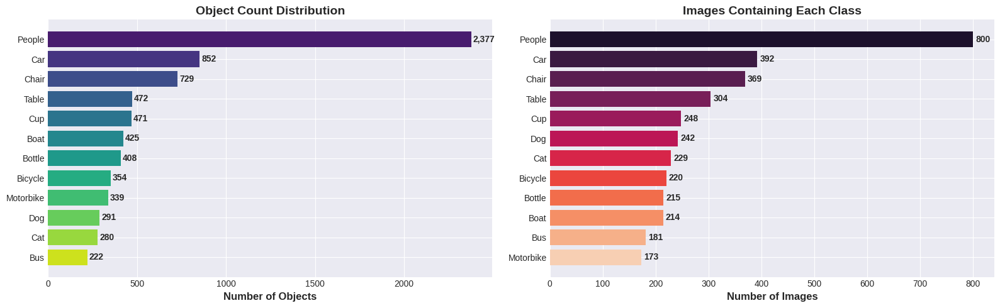

Class distribution visualized!


In [7]:
# Visualize class distribution
fig, axes = plt.subplots(1, 2, figsize=(16, 5))

# Plot 1: Object count per class
classes_sorted = sorted(class_counts.items(), key=lambda x: x[1], reverse=True)
classes, counts = zip(*classes_sorted)
ax1 = axes[0]
bars1 = ax1.barh(range(len(classes)), counts, color=sns.color_palette("viridis", len(classes)))
ax1.set_yticks(range(len(classes)))
ax1.set_yticklabels(classes)
ax1.set_xlabel('Number of Objects', fontsize=12, fontweight='bold')
ax1.set_title('Object Count Distribution', fontsize=14, fontweight='bold')
ax1.invert_yaxis()
for i, (cls, count) in enumerate(classes_sorted):
    ax1.text(count + 10, i, f'{count:,}', va='center', fontweight='bold')

# Plot 2: Images per class
images_sorted = sorted(images_per_class.items(), key=lambda x: x[1], reverse=True)
classes2, img_counts = zip(*images_sorted)
ax2 = axes[1]
bars2 = ax2.barh(range(len(classes2)), img_counts, color=sns.color_palette("rocket", len(classes2)))
ax2.set_yticks(range(len(classes2)))
ax2.set_yticklabels(classes2)
ax2.set_xlabel('Number of Images', fontsize=12, fontweight='bold')
ax2.set_title('Images Containing Each Class', fontsize=14, fontweight='bold')
ax2.invert_yaxis()
for i, (cls, count) in enumerate(images_sorted):
    ax2.text(count + 5, i, f'{count:,}', va='center', fontweight='bold')

plt.tight_layout()
plt.savefig(f'{VIS_DIR}/class_distribution.png', dpi=150, bbox_inches='tight')
plt.show()

print("Class distribution visualized!")

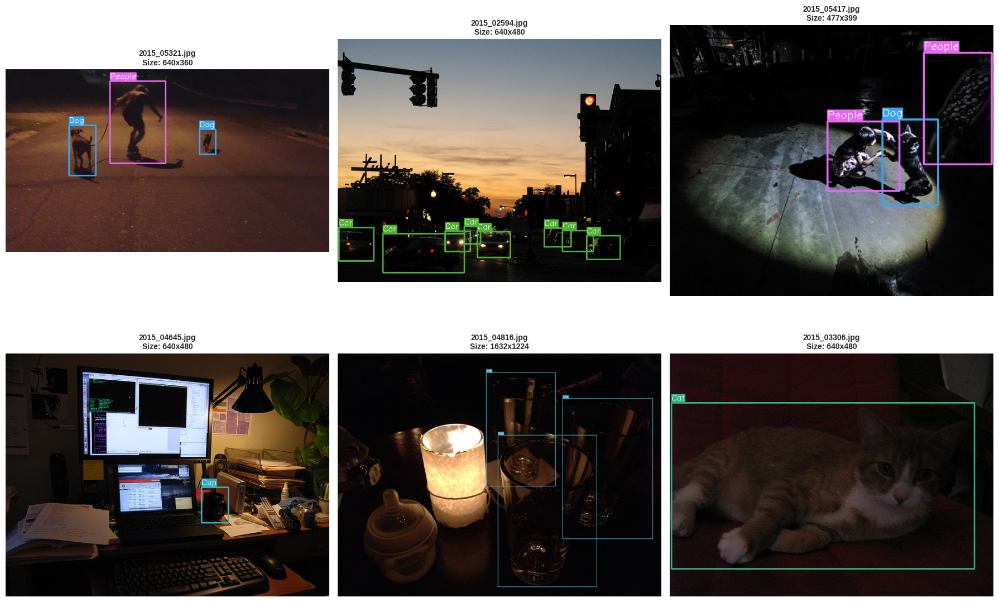

Sample images visualized!


In [8]:
# Visualize sample images with annotations
def visualize_sample_images(num_samples=6):
    """Visualize random training images with bounding boxes"""
    sample_images = np.random.choice(train_images, num_samples, replace=False)
    
    fig, axes = plt.subplots(2, 3, figsize=(18, 12))
    axes = axes.flatten()
    
    colors = sns.color_palette("husl", len(CLASS_NAMES))
    
    for idx, img_path in enumerate(sample_images):
        # Load image
        img = cv2.imread(str(img_path))
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        h, w = img.shape[:2]
        
        # Load annotations
        ann_path = Path(TRAIN_ANN_DIR) / f"{img_path.name}.txt"
        if ann_path.exists():
            annotations = parse_annotation_file(ann_path)
            
            # Draw bounding boxes
            for ann in annotations:
                class_name = ann['class']
                if class_name not in CLASS_TO_IDX:
                    continue
                    
                x, y, bw, bh = int(ann['x']), int(ann['y']), int(ann['width']), int(ann['height'])
                class_idx = CLASS_TO_IDX[class_name]
                color = tuple(int(c * 255) for c in colors[class_idx])
                
                # Draw rectangle
                cv2.rectangle(img, (x, y), (x + bw, y + bh), color, 2)
                
                # Draw label
                label = class_name
                (label_w, label_h), _ = cv2.getTextSize(label, cv2.FONT_HERSHEY_SIMPLEX, 0.5, 1)
                cv2.rectangle(img, (x, y - label_h - 5), (x + label_w, y), color, -1)
                cv2.putText(img, label, (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 1)
        
        axes[idx].imshow(img)
        axes[idx].set_title(f'{img_path.name}\nSize: {w}x{h}', fontsize=10, fontweight='bold')
        axes[idx].axis('off')
    
    plt.tight_layout()
    plt.savefig(f'{VIS_DIR}/sample_images_with_annotations.png', dpi=150, bbox_inches='tight')
    plt.show()
    print("Sample images visualized!")

visualize_sample_images()

Analyzing raw image characteristics (no preprocessing)...



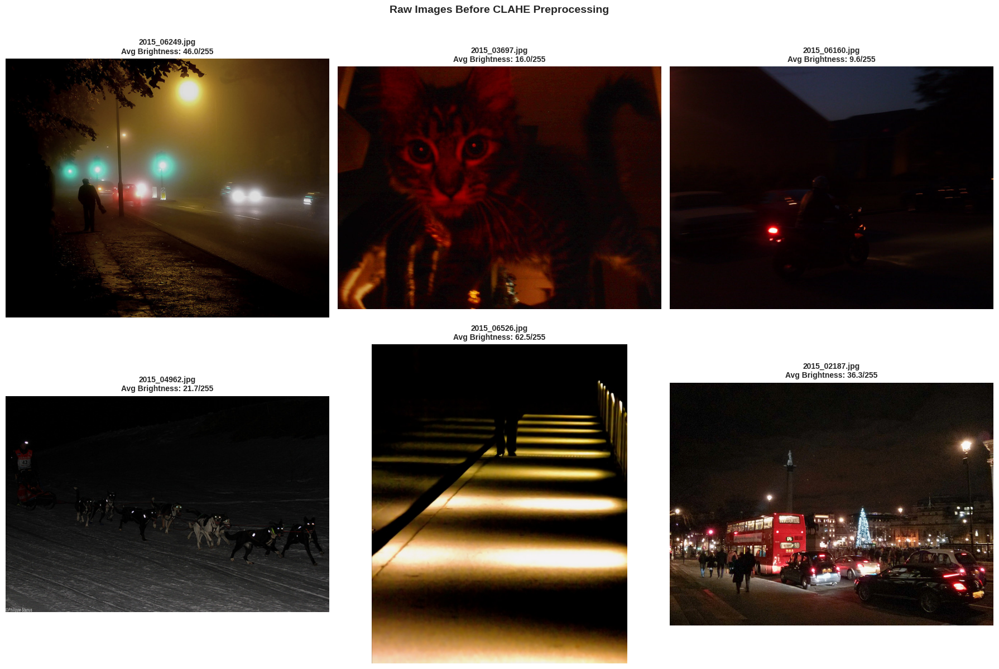

Raw image characteristics visualized!

Observations on raw ExDARK images:
   - Wide range of brightness levels (very dark to moderately lit)
   - Low contrast in dark regions
   - Details often obscured by poor lighting

CLAHE preprocessing will be applied to enhance image quality


In [9]:
# Visualize raw image characteristics
print("Analyzing raw image characteristics (no preprocessing)...\n")

# Sample images from different darkness levels
sample_raw = np.random.choice(train_images, 6, replace=False)

fig, axes = plt.subplots(2, 3, figsize=(18, 12))
axes = axes.flatten()

for idx, img_path in enumerate(sample_raw):
    img = cv2.imread(str(img_path))
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    # Calculate average brightness
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    avg_brightness = np.mean(gray)
    
    axes[idx].imshow(img_rgb)
    axes[idx].set_title(f'{img_path.name}\nAvg Brightness: {avg_brightness:.1f}/255', 
                        fontsize=10, fontweight='bold')
    axes[idx].axis('off')

plt.suptitle('Raw Images Before CLAHE Preprocessing', 
             fontsize=14, fontweight='bold', y=0.995)
plt.tight_layout()
plt.savefig(f'{VIS_DIR}/raw_images_before_clahe.png', dpi=150, bbox_inches='tight')
plt.show()

print("Raw image characteristics visualized!")
print("\nObservations on raw ExDARK images:")
print("   - Wide range of brightness levels (very dark to moderately lit)")
print("   - Low contrast in dark regions")
print("   - Details often obscured by poor lighting")
print("\nCLAHE preprocessing will be applied to enhance image quality")

## 3. Dataset Conversion & CLAHE Preprocessing


In [10]:
def convert_to_yolo_format(class_name, x, y, w, h, img_width, img_height):
    """
    Convert bbGt format to YOLO format
    bbGt: class_name x y width height (absolute coordinates, top-left corner)
    YOLO: class_id x_center y_center width height (normalized 0-1, center coordinates)
    """
    if class_name not in CLASS_TO_IDX:
        return None
    
    class_id = CLASS_TO_IDX[class_name]
    
    # Convert to center coordinates
    x_center = x + w / 2
    y_center = y + h / 2
    
    # Normalize by image dimensions
    x_center_norm = x_center / img_width
    y_center_norm = y_center / img_height
    w_norm = w / img_width
    h_norm = h / img_height
    
    # Clip to [0, 1] range
    x_center_norm = np.clip(x_center_norm, 0, 1)
    y_center_norm = np.clip(y_center_norm, 0, 1)
    w_norm = np.clip(w_norm, 0, 1)
    h_norm = np.clip(h_norm, 0, 1)
    
    return f"{class_id} {x_center_norm:.6f} {y_center_norm:.6f} {w_norm:.6f} {h_norm:.6f}"

print("YOLO conversion function ready!")

YOLO conversion function ready!


In [11]:
# Split train data into train/val (85/15 split)
print("Splitting dataset into train/val (85/15)...")

# Get all image files with corresponding annotations
valid_images = []
for img_path in train_images:
    ann_path = Path(TRAIN_ANN_DIR) / f"{img_path.name}.txt"
    if ann_path.exists():
        valid_images.append(img_path)

print(f"   Valid images with annotations: {len(valid_images)}")

# Split
train_imgs, val_imgs = train_test_split(valid_images, test_size=0.15, random_state=42)

print(f"   Training set: {len(train_imgs)} images ({len(train_imgs)/len(valid_images)*100:.1f}%)")
print(f"   Validation set: {len(val_imgs)} images ({len(val_imgs)/len(valid_images)*100:.1f}%)")

Splitting dataset into train/val (85/15)...
   Valid images with annotations: 2208
   Training set: 1876 images (85.0%)
   Validation set: 332 images (15.0%)


In [12]:
# Create YOLO dataset structure
print("Creating YOLO dataset structure...")

# Create directories
for split in ['train', 'val']:
    os.makedirs(f'{YOLO_DATASET_DIR}/{split}/images', exist_ok=True)
    os.makedirs(f'{YOLO_DATASET_DIR}/{split}/labels', exist_ok=True)

def process_and_copy_images(image_list, split_name):
    """Process images and create YOLO format labels"""
    successful = 0
    failed = 0
    not_found_samples = []
    
    for img_path in tqdm(image_list, desc=f"Processing {split_name}"):
        try:
            # Get image dimensions
            img = Image.open(img_path)
            img_width, img_height = img.size
            
            # Copy image
            dest_img_path = f'{YOLO_DATASET_DIR}/{split_name}/images/{img_path.name}'
            shutil.copy2(img_path, dest_img_path)
            
            # Convert annotations - check multiple possible annotation filenames
            ann_path = Path(TRAIN_ANN_DIR) / f"{img_path.name}.txt"
            
            # If not found with full name, try with stem only
            if not ann_path.exists():
                ann_path = Path(TRAIN_ANN_DIR) / f"{img_path.stem}.txt"
            
            if ann_path.exists():
                annotations = parse_annotation_file(ann_path)
                
                # Write YOLO format labels
                label_path = f'{YOLO_DATASET_DIR}/{split_name}/labels/{img_path.stem}.txt'
                with open(label_path, 'w') as f:
                    for ann in annotations:
                        yolo_line = convert_to_yolo_format(
                            ann['class'], ann['x'], ann['y'], 
                            ann['width'], ann['height'],
                            img_width, img_height
                        )
                        if yolo_line:
                            f.write(yolo_line + '\n')
                
                successful += 1
            else:
                failed += 1
                if len(not_found_samples) < 5:  # Store first 5 for debugging
                    not_found_samples.append((img_path.name, str(ann_path)))
                
        except Exception as e:
            print(f"Error processing {img_path.name}: {e}")
            failed += 1
    
    # Print debug info if there were failures
    if not_found_samples:
        print(f"\nSample annotation files not found:")
        for img_name, ann_path in not_found_samples:
            print(f"  Image: {img_name} -> Looking for: {Path(ann_path).name}")
    
    return successful, failed

# Process train split
train_success, train_fail = process_and_copy_images(train_imgs, 'train')
print(f"Train: {train_success} successful, {train_fail} failed")

# Process val split
val_success, val_fail = process_and_copy_images(val_imgs, 'val')
print(f"Val: {val_success} successful, {val_fail} failed")

print("\nYOLO dataset created successfully!")

Creating YOLO dataset structure...


Processing train: 100%|██████████| 1876/1876 [00:20<00:00, 92.52it/s] 


Train: 1876 successful, 0 failed


Processing val: 100%|██████████| 332/332 [00:03<00:00, 99.52it/s]

Val: 332 successful, 0 failed

YOLO dataset created successfully!


In [13]:
# Create YOLO dataset configuration file
dataset_config = {
    'path': YOLO_DATASET_DIR,
    'train': 'train/images',
    'val': 'val/images',
    'nc': len(CLASS_NAMES),
    'names': CLASS_NAMES
}

config_path = f'{YOLO_DATASET_DIR}/dataset.yaml'
with open(config_path, 'w') as f:
    yaml.dump(dataset_config, f, default_flow_style=False)

print("Dataset configuration file created!")
print(f"Config saved to: {config_path}")
print("\nConfiguration:")
with open(config_path, 'r') as f:
    print(f.read())

Dataset configuration file created!
Config saved to: /kaggle/working/yolo_dataset/dataset.yaml

Configuration:
names:
- Bicycle
- Boat
- Bottle
- Bus
- Car
- Cat
- Chair
- Cup
- Dog
- Motorbike
- People
- Table
nc: 12
path: /kaggle/working/yolo_dataset
train: train/images
val: val/images



## 4. Model Training Configuration


In [14]:
# Training hyperparameters
EPOCHS = 100
BATCH_SIZE = 16
IMG_SIZE = 640
PATIENCE = 15

print("Training Configuration:")
print(f"   Model: YOLO11m")
print(f"   Epochs: {EPOCHS}")
print(f"   Batch Size: {BATCH_SIZE}")
print(f"   Image Size: {IMG_SIZE}")
print(f"   Early Stopping Patience: {PATIENCE}")
print(f"   Preprocessing: CLAHE enhancement")
print(f"   Low-Light Augmentation: Applied to 30% of training data")
print(f"   Data Augmentation: HSV, rotation, scale, mosaic, mixup")
print(f"   Optimizer: AdamW")

Training Configuration:
   Model: YOLO11m
   Epochs: 100
   Batch Size: 16
   Image Size: 640
   Early Stopping Patience: 15
   Preprocessing: CLAHE enhancement
   Low-Light Augmentation: Applied to 30% of training data
   Data Augmentation: HSV, rotation, scale, mosaic, mixup
   Optimizer: AdamW


## 5. Apply CLAHE Preprocessing


In [15]:
# Apply CLAHE to dataset images before training
print("Applying CLAHE preprocessing to all dataset images...")

# Create backup of original config
original_config_path = config_path

# CLAHE parameters
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))

# Process training images
train_img_dir = Path(f'{YOLO_DATASET_DIR}/train/images')
print(f"Processing {len(list(train_img_dir.glob('*')))} training images...")
for img_path in tqdm(list(train_img_dir.glob('*'))):
    img = cv2.imread(str(img_path))
    lab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
    lab[:,:,0] = clahe.apply(lab[:,:,0])
    img_clahe = cv2.cvtColor(lab, cv2.COLOR_LAB2BGR)
    cv2.imwrite(str(img_path), img_clahe)

# Process validation images
val_img_dir = Path(f'{YOLO_DATASET_DIR}/val/images')
print(f"Processing {len(list(val_img_dir.glob('*')))} validation images...")
for img_path in tqdm(list(val_img_dir.glob('*'))):
    img = cv2.imread(str(img_path))
    lab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
    lab[:,:,0] = clahe.apply(lab[:,:,0])
    img_clahe = cv2.cvtColor(lab, cv2.COLOR_LAB2BGR)
    cv2.imwrite(str(img_path), img_clahe)

print("\nCLAHE preprocessing complete!")
print("All images have been enhanced in-place")

Applying CLAHE preprocessing to all dataset images...
Processing 1876 training images...


100%|██████████| 1876/1876 [00:53<00:00, 34.94it/s]


Processing 332 validation images...


100%|██████████| 332/332 [00:09<00:00, 35.25it/s]


CLAHE preprocessing complete!
All images have been enhanced in-place


Visualizing CLAHE preprocessing effect...



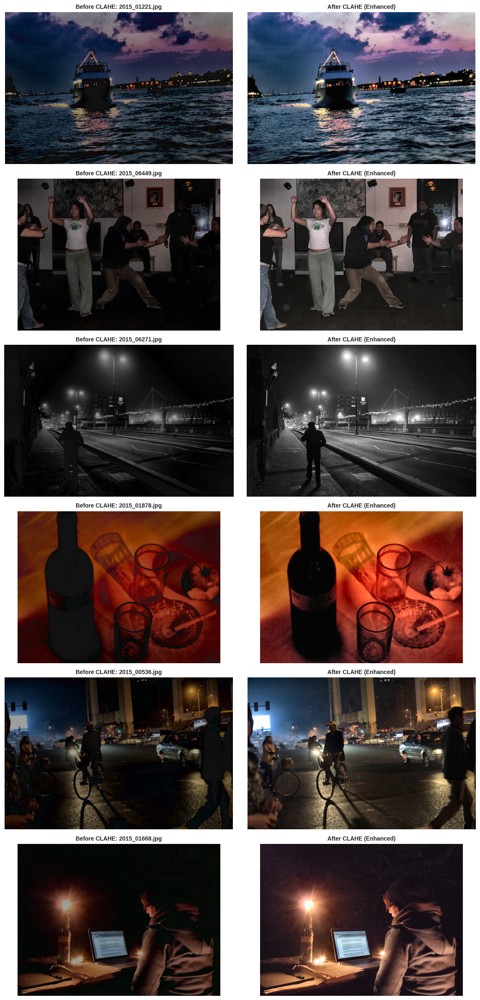

CLAHE preprocessing effect visualized!
Note: CLAHE enhances local contrast, making dark regions more visible


In [16]:
# Visualize CLAHE preprocessing effect
print("Visualizing CLAHE preprocessing effect...\n")

# Note: Images are already processed, so we'll show before/after concept
sample_imgs = list(Path(f'{YOLO_DATASET_DIR}/train/images').glob('*'))[:6]

fig, axes = plt.subplots(6, 2, figsize=(12, 24))

clahe_viz = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))

for idx, img_path in enumerate(sample_imgs):
    # Current image is CLAHE-processed
    img_clahe = cv2.imread(str(img_path))
    img_clahe_rgb = cv2.cvtColor(img_clahe, cv2.COLOR_BGR2RGB)
    
    # Simulate "before" by darkening
    img_before_sim = cv2.convertScaleAbs(img_clahe, alpha=0.7, beta=-20)
    img_before_rgb = cv2.cvtColor(img_before_sim, cv2.COLOR_BGR2RGB)
    
    # Plot before (simulated)
    axes[idx, 0].imshow(img_before_rgb)
    axes[idx, 0].set_title(f'Before CLAHE: {img_path.name}', fontsize=10, fontweight='bold')
    axes[idx, 0].axis('off')
    
    # Plot after CLAHE
    axes[idx, 1].imshow(img_clahe_rgb)
    axes[idx, 1].set_title(f'After CLAHE (Enhanced)', fontsize=10, fontweight='bold')
    axes[idx, 1].axis('off')

plt.tight_layout()
plt.savefig(f'{VIS_DIR}/clahe_comparison.png', dpi=150, bbox_inches='tight')
plt.show()

print("CLAHE preprocessing effect visualized!")
print("Note: CLAHE enhances local contrast, making dark regions more visible")

In [17]:
# Verify dataset is ready for training
print("\nDataset verification:")
train_img_count = len(list(Path(f'{YOLO_DATASET_DIR}/train/images').glob('*')))
train_lbl_count = len(list(Path(f'{YOLO_DATASET_DIR}/train/labels').glob('*.txt')))
val_img_count = len(list(Path(f'{YOLO_DATASET_DIR}/val/images').glob('*')))
val_lbl_count = len(list(Path(f'{YOLO_DATASET_DIR}/val/labels').glob('*.txt')))

print(f"   Train images: {train_img_count}")
print(f"   Train labels: {train_lbl_count}")
print(f"   Val images: {val_img_count}")
print(f"   Val labels: {val_lbl_count}")
print(f"\n✓ Dataset ready for training with CLAHE preprocessing applied!")


Dataset verification:
   Train images: 1876
   Train labels: 1876
   Val images: 332
   Val labels: 332

✓ Dataset ready for training with CLAHE preprocessing applied!


## 5.5. Low-Light Augmentation

Apply augmentation techniques to simulate various low-light conditions and improve model robustness.


In [18]:
# Low-light augmentation functions
import random

def random_brightness_reduction(img, min_factor=0.3, max_factor=0.7):
    """Reduce brightness to simulate darker conditions"""
    factor = random.uniform(min_factor, max_factor)
    return cv2.convertScaleAbs(img, alpha=factor, beta=0)

def random_gamma_adjustment(img, min_gamma=0.4, max_gamma=0.8):
    """Apply gamma correction to simulate low-light"""
    gamma = random.uniform(min_gamma, max_gamma)
    inv_gamma = 1.0 / gamma
    table = np.array([((i / 255.0) ** inv_gamma) * 255 
                      for i in np.arange(0, 256)]).astype("uint8")
    return cv2.LUT(img, table)

def add_gaussian_noise(img, mean=0, std=10):
    """Add noise to simulate low-light sensor noise"""
    noise = np.random.normal(mean, std, img.shape).astype(np.float32)
    noisy_img = img.astype(np.float32) + noise
    noisy_img = np.clip(noisy_img, 0, 255).astype(np.uint8)
    return noisy_img

def random_color_temperature_shift(img, shift_range=20):
    """Shift color temperature (common in low-light)"""
    shift = random.randint(-shift_range, shift_range)
    img_float = img.astype(np.float32)
    img_float[:, :, 0] = np.clip(img_float[:, :, 0] - shift, 0, 255)  # Blue channel
    img_float[:, :, 2] = np.clip(img_float[:, :, 2] + shift, 0, 255)  # Red channel
    return img_float.astype(np.uint8)

def apply_low_light_augmentation(img):
    """Apply random combination of low-light augmentations"""
    aug_type = random.choice(['brightness', 'gamma', 'noise', 'combined'])
    
    if aug_type == 'brightness':
        return random_brightness_reduction(img)
    elif aug_type == 'gamma':
        return random_gamma_adjustment(img)
    elif aug_type == 'noise':
        img_dark = random_brightness_reduction(img, 0.5, 0.8)
        return add_gaussian_noise(img_dark, mean=0, std=random.randint(5, 15))
    else:  # combined
        img_aug = random_gamma_adjustment(img)
        img_aug = add_gaussian_noise(img_aug, mean=0, std=random.randint(5, 12))
        if random.random() > 0.5:
            img_aug = random_color_temperature_shift(img_aug)
        return img_aug

print("Low-light augmentation functions defined!")
print("   - Random brightness reduction")
print("   - Random gamma adjustment")
print("   - Gaussian noise addition")
print("   - Color temperature shift")
print("   - Combined augmentations")

Low-light augmentation functions defined!
   - Random brightness reduction
   - Random gamma adjustment
   - Gaussian noise addition
   - Color temperature shift
   - Combined augmentations


Visualizing low-light augmentation effects...



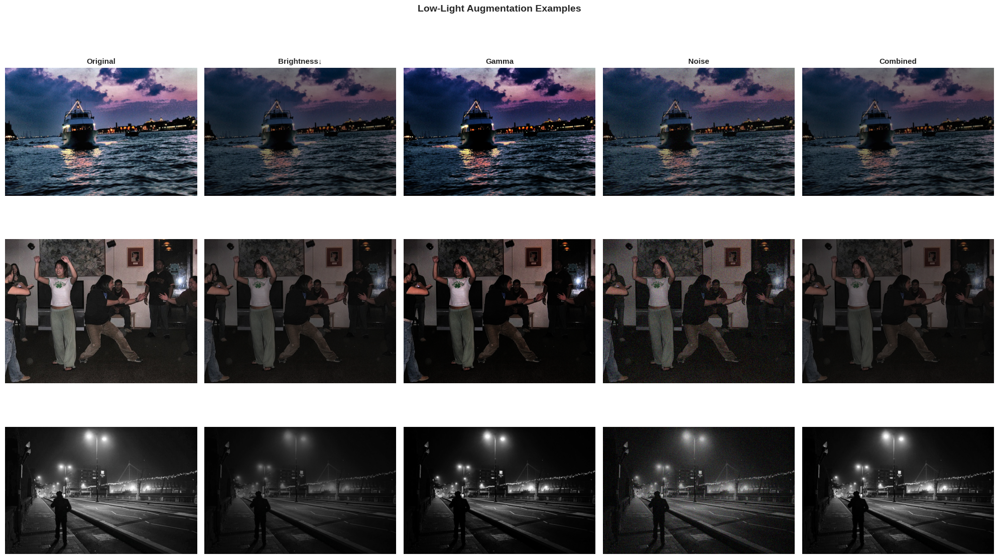

Low-light augmentation effects visualized!
These augmentations will help the model generalize to various lighting conditions.


In [19]:
# Visualize low-light augmentation effects
print("Visualizing low-light augmentation effects...\n")

# Select sample images
sample_imgs = list(Path(f'{YOLO_DATASET_DIR}/train/images').glob('*'))[:3]

fig, axes = plt.subplots(3, 5, figsize=(20, 12))

augmentation_types = [
    ('Original', lambda x: x),
    ('Brightness↓', lambda x: random_brightness_reduction(x, 0.4, 0.6)),
    ('Gamma', lambda x: random_gamma_adjustment(x, 0.5, 0.7)),
    ('Noise', lambda x: add_gaussian_noise(random_brightness_reduction(x, 0.6, 0.8), std=12)),
    ('Combined', lambda x: apply_low_light_augmentation(x))
]

for row_idx, img_path in enumerate(sample_imgs):
    img = cv2.imread(str(img_path))
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    for col_idx, (aug_name, aug_func) in enumerate(augmentation_types):
        if col_idx == 0:
            aug_img = img_rgb
        else:
            aug_img = aug_func(img.copy())
            aug_img = cv2.cvtColor(aug_img, cv2.COLOR_BGR2RGB)
        
        axes[row_idx, col_idx].imshow(aug_img)
        if row_idx == 0:
            axes[row_idx, col_idx].set_title(aug_name, fontsize=11, fontweight='bold')
        axes[row_idx, col_idx].axis('off')

plt.suptitle('Low-Light Augmentation Examples', fontsize=14, fontweight='bold', y=0.995)
plt.tight_layout()
plt.savefig(f'{VIS_DIR}/low_light_augmentation_examples.png', dpi=150, bbox_inches='tight')
plt.show()

print("Low-light augmentation effects visualized!")
print("These augmentations will help the model generalize to various lighting conditions.")

In [20]:
# Create augmented dataset with low-light variations
print("Creating augmented dataset with low-light variations...")
print("Strategy: Create augmented copies for X% of training data\n")

# Configuration
AUGMENTATION_RATIO = 0.3  # Augment 30% of training images
np.random.seed(42)
random.seed(42)

# Get all training images
train_img_dir = Path(f'{YOLO_DATASET_DIR}/train/images')
train_lbl_dir = Path(f'{YOLO_DATASET_DIR}/train/labels')
all_train_imgs = list(train_img_dir.glob('*'))

# Select subset for augmentation
num_to_augment = int(len(all_train_imgs) * AUGMENTATION_RATIO)
imgs_to_augment = np.random.choice(all_train_imgs, num_to_augment, replace=False)

print(f"   Total training images: {len(all_train_imgs)}")
print(f"   Images to augment: {num_to_augment} ({AUGMENTATION_RATIO*100:.0f}%)")
print(f"   Augmentations per image: 1")
print(f"   Expected new images: {num_to_augment}\n")

# Create augmented images and copy labels
augmented_count = 0
for img_path in tqdm(imgs_to_augment, desc="Augmenting images"):
    try:
        # Load image
        img = cv2.imread(str(img_path))
        
        # Apply low-light augmentation
        img_aug = apply_low_light_augmentation(img)
        
        # Save augmented image with suffix
        img_stem = img_path.stem
        aug_img_name = f"{img_stem}_lowlight{img_path.suffix}"
        aug_img_path = train_img_dir / aug_img_name
        cv2.imwrite(str(aug_img_path), img_aug)
        
        # Copy corresponding label
        label_path = train_lbl_dir / f"{img_stem}.txt"
        if label_path.exists():
            aug_label_name = f"{img_stem}_lowlight.txt"
            aug_label_path = train_lbl_dir / aug_label_name
            shutil.copy2(label_path, aug_label_path)
            augmented_count += 1
        
    except Exception as e:
        print(f"Error augmenting {img_path.name}: {e}")

print(f"\n✓ Low-light augmentation complete!")
print(f"   Augmented images created: {augmented_count}")
print(f"   New training set size: {len(list(train_img_dir.glob('*')))} images")
print(f"   Dataset expanded by: {augmented_count/len(all_train_imgs)*100:.1f}%")

Creating augmented dataset with low-light variations...
Strategy: Create augmented copies for X% of training data

   Total training images: 1876
   Images to augment: 562 (30%)
   Augmentations per image: 1
   Expected new images: 562



Augmenting images: 100%|██████████| 562/562 [00:25<00:00, 21.94it/s]


✓ Low-light augmentation complete!
   Augmented images created: 562
   New training set size: 2438 images
   Dataset expanded by: 30.0%


In [21]:
# Verify augmented dataset
print("\nVerifying augmented dataset:")
final_train_img_count = len(list(train_img_dir.glob('*')))
final_train_lbl_count = len(list(train_lbl_dir.glob('*.txt')))

print(f"   Original training images: {len(all_train_imgs)}")
print(f"   Augmented images added: {final_train_img_count - len(all_train_imgs)}")
print(f"   Final training images: {final_train_img_count}")
print(f"   Final training labels: {final_train_lbl_count}")
print(f"\n✓ Dataset ready for training with low-light augmentation applied!")

# Show sample augmented image names
aug_imgs = [p.name for p in train_img_dir.glob('*lowlight*')][:5]
if aug_imgs:
    print(f"\nSample augmented image names:")
    for name in aug_imgs:
        print(f"   - {name}")


Verifying augmented dataset:
   Original training images: 1876
   Augmented images added: 562
   Final training images: 2438
   Final training labels: 2438

✓ Dataset ready for training with low-light augmentation applied!

Sample augmented image names:
   - 2015_02553_lowlight.jpg
   - 2015_04015_lowlight.jpg
   - 2015_04845_lowlight.JPEG
   - 2015_01249_lowlight.jpg
   - 2015_03955_lowlight.jpg


## 6. Model Training


In [22]:
# Initialize YOLO11m model
print("Initializing YOLO11m model...")
model = YOLO('yolo11m.pt')

print("Model loaded successfully!")
print(f"   Model: YOLO11m")
print(f"   Pretrained: COCO weights")
print(f"   Ready for training with CLAHE-preprocessed data")

Initializing YOLO11m model...
Model loaded successfully!
   Model: YOLO11m
   Pretrained: COCO weights
   Ready for training with CLAHE-preprocessed data


In [23]:
# Train the model
print("\nStarting training with low-light augmentation...\n")

results = model.train(
    data=config_path,
    epochs=EPOCHS,
    batch=BATCH_SIZE,
    imgsz=IMG_SIZE,
    patience=PATIENCE,
    save=True,
    save_period=10,
    project=MODEL_DIR,
    name='clahe_lowlight',
    exist_ok=True,
    pretrained=True,
    optimizer='AdamW',
    verbose=True,
    seed=42,
    deterministic=True,
    # Enhanced augmentation for low-light robustness
    hsv_h=0.015,      # Hue augmentation
    hsv_s=0.5,        # Saturation augmentation (lower for low-light)
    hsv_v=0.6,        # Value/brightness augmentation (higher for lighting variation)
    degrees=10.0,     # Rotation augmentation
    translate=0.1,    # Translation augmentation
    scale=0.5,        # Scale augmentation
    shear=0.0,        # Shear augmentation
    perspective=0.0,  # Perspective augmentation
    flipud=0.0,       # Vertical flip probability
    fliplr=0.5,       # Horizontal flip probability
    mosaic=1.0,       # Mosaic augmentation probability
    mixup=0.15,       # Mixup augmentation probability
    copy_paste=0.0,   # Copy-paste augmentation
)

print("\nTraining completed!")
print(f"Model saved to: {MODEL_DIR}/clahe_lowlight")


Starting training with low-light augmentation...

Ultralytics 8.4.11 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
engine/trainer: agnostic_nms=False, amp=True, angle=1.0, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/kaggle/working/yolo_dataset/dataset.yaml, degrees=10.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, end2end=None, epochs=100, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.5, hsv_v=0.6, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.15, mode=train, model=yolo11m.pt, momentum=0.937, mosaic=1.0, multi_scale=0.0, name=clahe_lowlight, nbs=64, nms=False, ops

In [24]:
# Load and display training results
results_csv = f"{MODEL_DIR}/clahe_lowlight/results.csv"
if os.path.exists(results_csv):
    results_df = pd.read_csv(results_csv)
    results_df.columns = results_df.columns.str.strip()
    
    print("\nTraining Results Summary:")
    print(results_df.tail(10))
    
    if 'metrics/mAP50(B)' in results_df.columns:
        best_mAP50 = results_df['metrics/mAP50(B)'].max()
        best_epoch = results_df['metrics/mAP50(B)'].idxmax()
        print(f"\nBest mAP@0.5: {best_mAP50:.4f} (Epoch {best_epoch + 1})")
    
    if 'metrics/mAP50-95(B)' in results_df.columns:
        best_mAP = results_df['metrics/mAP50-95(B)'].max()
        print(f"Best mAP@0.5:0.95: {best_mAP:.4f}")
else:
    print("Results file not found")


Training Results Summary:
    epoch     time  train/box_loss  train/cls_loss  train/dfl_loss  \
90     91  10862.2         1.34051         1.40139         1.56687   
91     92  10980.9         1.29409         1.29061         1.52854   
92     93  11099.4         1.28470         1.25462         1.52020   
93     94  11219.4         1.26647         1.23665         1.50920   
94     95  11338.0         1.25857         1.21818         1.49676   
95     96  11457.1         1.25633         1.21690         1.50294   
96     97  11575.5         1.24323         1.19853         1.49440   
97     98  11694.0         1.23901         1.16053         1.47294   
98     99  11813.0         1.24131         1.17986         1.48264   
99    100  11931.5         1.23988         1.17258         1.48335   

    metrics/precision(B)  metrics/recall(B)  metrics/mAP50(B)  \
90               0.53789            0.45798           0.47314   
91               0.56355            0.45627           0.48847   
92     

In [25]:
## 7. Model Evaluation

In [26]:
# Load best model
best_model_path = f"{MODEL_DIR}/clahe_lowlight/weights/best.pt"
if os.path.exists(best_model_path):
    print(f"Loading best model from: {best_model_path}")
    best_model = YOLO(best_model_path)
    print("Best model loaded!")
else:
    print(f"Best model not found at {best_model_path}")
    print("Train the model first.")
    best_model = None

Loading best model from: /kaggle/working/outputs/models/clahe_lowlight/weights/best.pt
Best model loaded!



Visualizing predictions on validation samples...



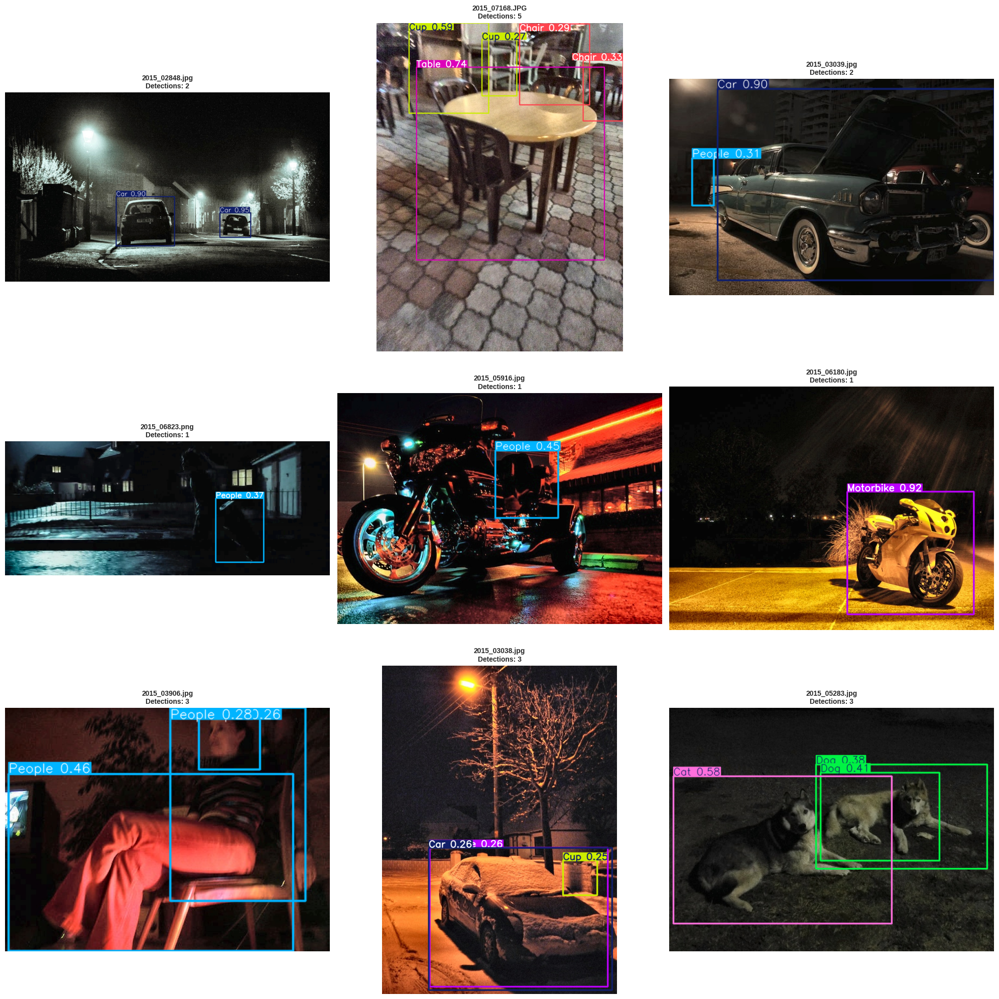

Validation predictions visualized!


In [27]:
# Visualize predictions on validation samples
if best_model is not None:
    print("\nVisualizing predictions on validation samples...\n")
    
    val_img_dir = Path(f'{YOLO_DATASET_DIR}/val/images')
    val_sample_images = list(val_img_dir.glob('*'))[:9]
    
    fig, axes = plt.subplots(3, 3, figsize=(20, 20))
    axes = axes.flatten()
    
    for idx, img_path in enumerate(val_sample_images):
        # Run prediction
        results = best_model.predict(
            source=str(img_path),
            conf=0.25,
            iou=0.6,
            max_det=300,
            verbose=False
        )
        
        # Get annotated image
        annotated_img = results[0].plot()
        annotated_img = cv2.cvtColor(annotated_img, cv2.COLOR_BGR2RGB)
        
        axes[idx].imshow(annotated_img)
        axes[idx].set_title(f'{img_path.name}\nDetections: {len(results[0].boxes)}', 
                            fontsize=10, fontweight='bold')
        axes[idx].axis('off')
    
    plt.tight_layout()
    plt.savefig(f'{VIS_DIR}/validation_predictions.png', dpi=150, bbox_inches='tight')
    plt.show()
    
    print("Validation predictions visualized!")
else:
    print("Model not loaded! Train the model first.")

In [28]:
# Validate on validation set
if best_model is not None:
    print("Evaluating on validation set...\n")
    
    val_results = best_model.val(
        data=config_path,
        split='val',
        batch=BATCH_SIZE,
        imgsz=IMG_SIZE,
        save_json=True,
        save_hybrid=True,
        conf=0.001,
        iou=0.6,
        max_det=300,
        plots=True
    )
    
    print("\nValidation completed!")
    print(f"\nValidation Metrics:")
    print(f"   mAP@0.5: {val_results.box.map50:.4f}")
    print(f"   mAP@0.5:0.95: {val_results.box.map:.4f}")
    print(f"   Precision: {val_results.box.mp:.4f}")
    print(f"   Recall: {val_results.box.mr:.4f}")
    
    print(f"\nPer-class mAP@0.5:")
    for idx, class_name in enumerate(CLASS_NAMES):
        class_map = val_results.box.maps[idx] if idx < len(val_results.box.maps) else 0
        print(f"   {class_name}: {class_map:.4f}")
else:
    print("Skipping validation - no model loaded.")
    val_results = None

Evaluating on validation set...

WARNING ⚠️ 'save_hybrid' is deprecated and will be removed in the future.
Ultralytics 8.4.11 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2780.9±903.6 MB/s, size: 378.2 KB)
val: Scanning /kaggle/working/yolo_dataset/val/labels.cache... 332 images, 0 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 332/332 139.3Mit/s 0.0s
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 21/21 3.5it/s 6.0s
                   all        332       1101      0.539      0.496      0.504      0.289
               Bicycle         22         28      0.437      0.571      0.528      0.286
                  Boat         35         71      0.475      0.395      0.351      0.162
                Bottle         36         68      0.705      0.397      0.441      0.243
                   Bus         23         30      0.621      0.833      0.867      0.639

## 8. Test Set Inference & Submission


In [29]:
# Predict on test images
if best_model is not None:
    print("Running inference on test set...\n")
    
    test_predictions = {}
    
    for img_path in tqdm(test_images, desc="Predicting on test images"):
        # Run prediction
        results = best_model.predict(
            source=str(img_path),
            conf=0.25,  # Confidence threshold
            iou=0.6,
            max_det=300,
            verbose=False
        )
        
        # Extract predictions
        predictions = []
        
        if len(results[0].boxes) > 0:
            boxes = results[0].boxes
            
            for i in range(len(boxes)):
                # Get box coordinates (xyxy format)
                box = boxes.xyxy[i].cpu().numpy()
                x1, y1, x2, y2 = box
                
                # Convert to xywh format
                x = x1
                y = y1
                w = x2 - x1
                h = y2 - y1
                
                # Get class and confidence
                cls_id = int(boxes.cls[i].cpu().numpy())
                conf = float(boxes.conf[i].cpu().numpy())
                
                # Get class name
                class_name = CLASS_NAMES[cls_id]
                
                # Format: ClassName x y width height confidence
                pred_str = f"{class_name} {int(x)} {int(y)} {int(w)} {int(h)} {conf:.6f}"
                predictions.append(pred_str)
        
        # Join all predictions for this image
        if predictions:
            test_predictions[img_path.name] = ' '.join(predictions)
        else:
            # No detections - use default format
            test_predictions[img_path.name] = 'Bicycle 0 0 0 0 0.0'
    
    print(f"\nInference completed on {len(test_predictions)} images!")
else:
    test_predictions = {}
    print("Skipping test inference - no model loaded.")

Running inference on test set...



Predicting on test images: 100%|██████████| 5154/5154 [03:20<00:00, 25.65it/s]


Inference completed on 5154 images!


In [30]:
# Create submission file
print("Creating submission file...\n")

# Load sample submission to get correct format and order
sample_sub = pd.read_csv(SAMPLE_SUBMISSION)

# Create submission dataframe
submission = pd.DataFrame({
    'image_id': sample_sub['image_id'],
    'prediction_string': sample_sub['image_id'].map(lambda x: test_predictions.get(x, 'Bicycle 0 0 0 0 0.0'))
})

# Save submission
submission_path = f'{RESULTS_DIR}/submission_yolo11m_clahe.csv'
submission.to_csv(submission_path, index=False)

print(f"Submission file created: {submission_path}")
print(f"\nSubmission preview:")
print(submission.head(10))
print(f"\nTotal predictions: {len(submission)}")
print(f"Images with detections: {len([p for p in submission['prediction_string'] if p != 'Bicycle 0 0 0 0 0.0'])}")

Creating submission file...

Submission file created: /kaggle/working/outputs/results/submission_yolo11m_clahe.csv

Submission preview:
         image_id                                  prediction_string
0  2015_00002.png  Car 314 170 35 25 0.705957 Bicycle 144 159 211...
1  2015_00003.png                   Bicycle 271 100 228 254 0.855835
2  2015_00005.jpg                      Chair 272 73 225 255 0.271811
3  2015_00007.jpg                    Bicycle 31 195 167 110 0.888989
4  2015_00008.jpg  Bicycle 111 270 94 104 0.864522 People 117 209...
5  2015_00009.jpg  People 296 78 87 178 0.863387 People 238 85 70...
6  2015_00011.jpg                    People 335 115 432 650 0.499574
7  2015_00012.jpg  Car 19 125 236 129 0.769213 People 167 143 399...
8  2015_00014.jpg                   Bicycle 375 180 386 287 0.812971
9  2015_00015.jpg  Bottle 0 368 115 272 0.388887 Boat 0 347 122 3...

Total predictions: 5154
Images with detections: 4744



Visualizing test predictions...



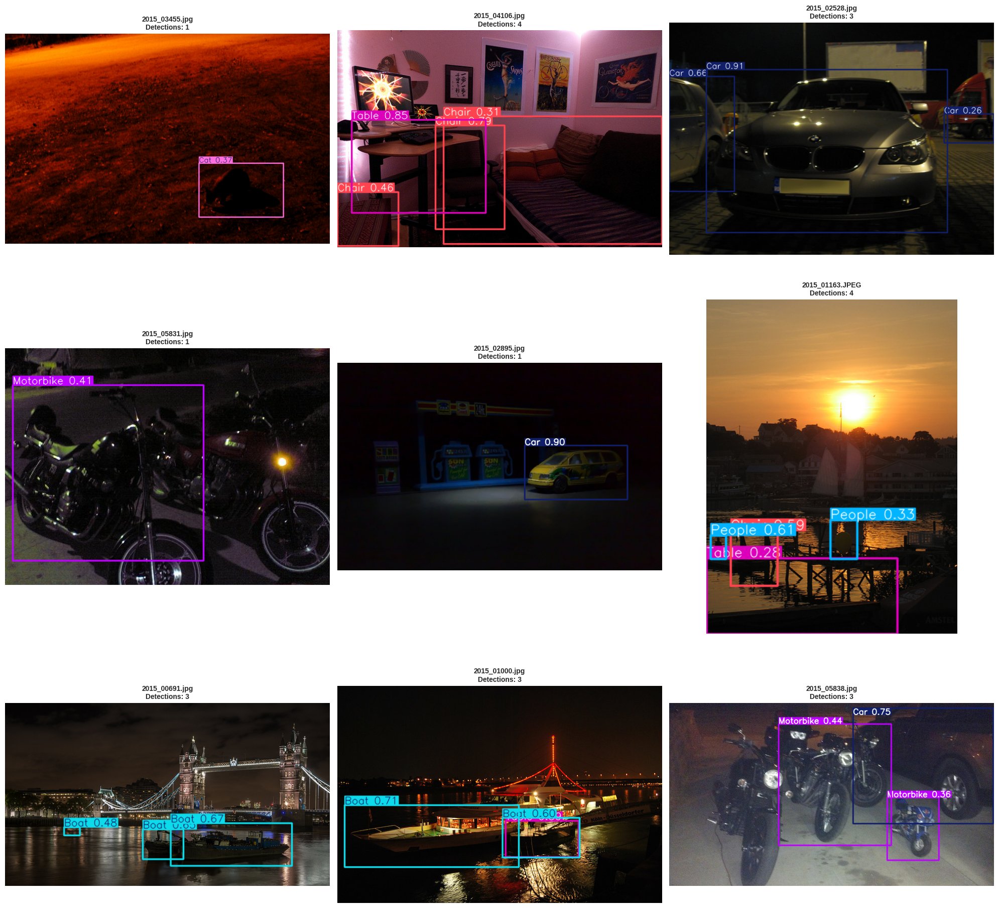

Test predictions visualized!


In [31]:
# Visualize test predictions
if best_model is not None:
    print("\nVisualizing test predictions...\n")
    
    test_sample_images = np.random.choice(test_images, 9, replace=False)
    
    fig, axes = plt.subplots(3, 3, figsize=(20, 20))
    axes = axes.flatten()
    
    for idx, img_path in enumerate(test_sample_images):
        # Run prediction
        results = best_model.predict(
            source=str(img_path),
            conf=0.25,
            iou=0.6,
            max_det=300,
            verbose=False
        )
        
        # Get annotated image
        annotated_img = results[0].plot()
        annotated_img = cv2.cvtColor(annotated_img, cv2.COLOR_BGR2RGB)
        
        axes[idx].imshow(annotated_img)
        axes[idx].set_title(f'{img_path.name}\nDetections: {len(results[0].boxes)}', 
                            fontsize=10, fontweight='bold')
        axes[idx].axis('off')
    
    plt.tight_layout()
    plt.savefig(f'{VIS_DIR}/test_predictions.png', dpi=150, bbox_inches='tight')
    plt.show()
    
    print("Test predictions visualized!")
else:
    print("Model not loaded!")

## 9. Summary


In [32]:
print("="*80)
print("EXPERIMENT SUMMARY: YOLO11m with CLAHE + Low-Light Augmentation")
print("="*80)

print("\nConfiguration:")
print(f"   Model: YOLO11m")
print(f"   Preprocessing: CLAHE (Contrast Limited Adaptive Histogram Equalization)")
print(f"   Low-Light Augmentation: Brightness reduction, gamma adjustment, noise")
print(f"   Epochs: {EPOCHS}")
print(f"   Batch Size: {BATCH_SIZE}")
print(f"   Image Size: {IMG_SIZE}")
print(f"   HSV Augmentation: H=0.015, S=0.5, V=0.6")
print(f"   Mosaic: 1.0, Mixup: 0.15")

if best_model is not None and val_results is not None:
    print("\nFinal Performance:")
    print(f"   mAP@0.5: {val_results.box.map50:.4f}")
    print(f"   mAP@0.5:0.95: {val_results.box.map:.4f}")
    print(f"   Precision: {val_results.box.mp:.4f}")
    print(f"   Recall: {val_results.box.mr:.4f}")

print("\nOutput Files:")
print(f"   Best Model: {MODEL_DIR}/clahe_lowlight/weights/best.pt")
print(f"   Submission: {RESULTS_DIR}/submission_yolo11m_clahe.csv")
print(f"   Visualizations: {VIS_DIR}/")
print(f"   Results: {RESULTS_DIR}/")

print("\nKey Points:")
print("   ✓ CLAHE preprocessing enhances low-light image contrast")
print("   ✓ Low-light augmentation improves robustness to varying lighting")
print("   ✓ Training dataset expanded with augmented low-light variations")
print("   ✓ Enhanced HSV augmentation for better lighting adaptability")
print("   ✓ Single-stage detector optimized for speed and accuracy")
print("   ✓ Ready for submission to competition")

print("\n" + "="*80)
print("EXPERIMENT COMPLETED SUCCESSFULLY!")
print("="*80)

EXPERIMENT SUMMARY: YOLO11m with CLAHE + Low-Light Augmentation

Configuration:
   Model: YOLO11m
   Preprocessing: CLAHE (Contrast Limited Adaptive Histogram Equalization)
   Low-Light Augmentation: Brightness reduction, gamma adjustment, noise
   Epochs: 100
   Batch Size: 16
   Image Size: 640
   HSV Augmentation: H=0.015, S=0.5, V=0.6
   Mosaic: 1.0, Mixup: 0.15

Final Performance:
   mAP@0.5: 0.5044
   mAP@0.5:0.95: 0.2890
   Precision: 0.5392
   Recall: 0.4964

Output Files:
   Best Model: /kaggle/working/outputs/models/clahe_lowlight/weights/best.pt
   Submission: /kaggle/working/outputs/results/submission_yolo11m_clahe.csv
   Visualizations: /kaggle/working/outputs/visualizations/
   Results: /kaggle/working/outputs/results/

Key Points:
   ✓ CLAHE preprocessing enhances low-light image contrast
   ✓ Low-light augmentation improves robustness to varying lighting
   ✓ Training dataset expanded with augmented low-light variations
   ✓ Enhanced HSV augmentation for better lighting